In [1]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Downloading Data

In [8]:
!gdown --id 1rv__dU681sTA0XzM9rB6g4LUQ7-P5epS

Traceback (most recent call last):
  File "/usr/local/bin/gdown", line 8, in <module>
    sys.exit(main())
  File "/usr/local/lib/python2.7/dist-packages/gdown/cli.py", line 61, in main
    quiet=args.quiet,
  File "/usr/local/lib/python2.7/dist-packages/gdown/download.py", line 52, in download
    res = sess.get(url, stream=True)



In [ ]:
!mv /content/CT_Scan.zip /content/drive/My\ Drive/BMI1/data

In [ ]:
!unzip /content/drive/My\ Drive/BMI1/data/CT_Scan.zip

In [ ]:
!rm -rf CT_Scan.zip

# Imports

In [2]:
!pip install pydicom

In [3]:
import torch 
import torch.nn as nn
import torch.nn.functional as F
import torchvision.datasets as dsets
from skimage import transform
from sklearn import metrics
from sklearn.metrics import confusion_matrix
import torchvision.transforms as transforms
from torch.autograd import Variable
import pandas as pd
import numpy as np
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt 
import random
import math
from PIL import Image
from skimage.morphology import ball, disk, dilation, binary_erosion, remove_small_objects, erosion, closing, reconstruction, binary_closing
from skimage.measure import label,regionprops, perimeter
from skimage.morphology import binary_dilation, binary_opening
from skimage.filters import roberts, sobel
from skimage import measure, feature
from skimage.segmentation import clear_border
import numpy as np
import os
import copy
import pydicom as dicom
from tqdm.auto import tqdm, trange
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from IPython import display
import scipy.ndimage as ndi
import matplotlib.pyplot as plt
from skimage import measure, morphology, segmentation
import scipy
import pickle
import random
from torchvision.models import alexnet, vgg19_bn

# Preprocessing Data

In [4]:
INPUT_FOLDER = '/content/drive/My Drive/BMI1/data/CT_Scan/LungCT-Diagnosis'

In [5]:
patients = os.listdir(INPUT_FOLDER)
patients.sort()

In [6]:
def get_pixels_hu(slices):
    image = np.stack([s.pixel_array for s in slices])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    for slice_number in range(len(slices)):
        
        intercept = slices[slice_number].RescaleIntercept
        slope = slices[slice_number].RescaleSlope
        
        if slope != 1:
            image[slice_number] = slope * image[slice_number].astype(np.float64)
            image[slice_number] = image[slice_number].astype(np.int16)
            
        image[slice_number] += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

In [8]:
def resample(image, scan, new_spacing=[1,1,1]):
    # Determine current pixel spacing
    spacing = np.array([scan[0].SliceThickness] + list(scan[0].PixelSpacing), dtype=np.float32)

    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor, mode='nearest')
    image = scipy.ndimage.interpolation.zoom(image, [1, 224/new_shape[1], 224/new_shape[2]], mode='nearest')
    return image, new_spacing

In [7]:
MIN_BOUND = -1000.0
MAX_BOUND = 400.0
    
def normalize(image):
    image = (image - MIN_BOUND) / (MAX_BOUND - MIN_BOUND)
    image[image>1] = 1.
    image[image<0] = 0.
    return image

In [8]:
def get_segmented_lungs(im, plot=False):
    
    binary = im < - 400
    cleared = clear_border(binary)
    label_image = label(cleared)
    areas = [r.area for r in regionprops(label_image)]
    areas.sort()
    is_bed_in_regions = False
    if len(areas) > 2:
        for region in regionprops(label_image):
            if region.area < areas[-3]:
                for coordinates in region.coords:                
                       label_image[coordinates[0], coordinates[1]] = 0
            else:
                if region.centroid[0] > 0.7 * im.shape[0]:
                    for coordinates in region.coords:                
                       label_image[coordinates[0], coordinates[1]] = 0
                    is_bed_in_regions = True
        
        if not is_bed_in_regions:
            for region in regionprops(label_image):
                if  areas[-2] <= region.area and region.area < areas[-2]:
                    for coordinates in region.coords:                
                        label_image[coordinates[0], coordinates[1]] = 0


    binary = label_image > 0
    selem = disk(2)
    binary = binary_erosion(binary, selem)
    selem = disk(10)
    binary = binary_closing(binary, selem)
    edges = roberts(binary)
    binary = ndi.binary_fill_holes(edges)
    get_high_vals = binary == 0
    im += 500
    im[get_high_vals] = -2000

        
    return im

In [9]:
def save(obj, PATH):
    with open(PATH, 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)


def load(PATH):
    with open(PATH, 'rb') as f:
        return pickle.load(f)

In [10]:
labels = pd.read_csv('/content/drive/My Drive/BMI1/data/labels.csv', header = None)
labels.columns = ['name', '1', 'vital_status', '3', '4']
label_dict={}
names = list(labels['name'])
status = list(labels['vital_status'])
for i in range(len(labels)):
    p = names[i]
    s = status[i]
    p = p.split('_')[1]
    p = "R_"+ p
    if s == '1 (ALIVE)':
        s = 1
    else:
        s=0
    label_dict[p] = s


In [13]:
all_slices = []
all_pixels = []
all_labels = []
for patient in patients:
    path = INPUT_FOLDER + "/" + patient
    slices = [] 
    for r,d,f in os.walk(path):
        for file in f:
            if file.__contains__('dcm'):
                slices.append(dicom.read_file(r +'/'+ file))

    ### find thickness for each scan in milimeter
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)

    if  slice_thickness  == 0:
        slice_thickness = 5.0

    
    for s in slices:
        s.SliceThickness = slice_thickness
    
    if len(slices) < 50 :
        continue
    
    all_slices.append(slices)
    pixels = get_pixels_hu(slices)
    pixels = np.asarray([get_segmented_lungs(slice) for slice in pixels])
    pix_resampled, spacing = resample(pixels, slices, [2,1,1])
    pix_resampled = normalize(pix_resampled)
    num_slices = pix_resampled.shape[0]
    pix_resampled = pix_resampled[(num_slices)//2 - 10 : num_slices//2 + 10]
    ### one channel / 3 dimension
    all_pixels.append([pix_resampled.tolist()])
    all_labels.append(label_dict[patient])


    

In [19]:
save(all_pixels, "/content/drive/My Drive/BMI1/data/dataset.pkl")
save(all_labels, "/content/drive/My Drive/BMI1/data/label.pkl")

In [11]:
all_pixels = load("/content/drive/My Drive/BMI1/data/dataset.pkl")
all_labels = load("/content/drive/My Drive/BMI1/data/label.pkl")

# Dataset


In [14]:
class LungDataset(Dataset):
    def __init__(self, X, y, transform = None):
        self.X =  np.array(X)
        self.X = torch.FloatTensor(self.X)
        self.y = torch.LongTensor(y)
        self.transform = transform
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        item = self.X[idx]
        label = self.y[idx]
        if self.transform :
            item = self.transform(item) 
        return (item, label)

In [15]:
train_transform = transforms.Compose([ transforms.RandomApply([
            transforms.RandomRotation([-30, 30])], p=0.5),
            transforms.RandomVerticalFlip(p=0.5),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.Resize(224),
    ])
val_transform = transforms.Compose([ 
            transforms.Resize(224),
            # transforms.ToTensor()
    ])

# Model

In [16]:
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    print("Running on the GPU")
else:
    device = torch.device("cpu")
    print("Running on the CPU")

Running on the GPU


In [17]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-c062b0c4-969b-3253-7cd4-2825c003a2fb)


In [18]:
class SimpleNet(nn.Module):
    def __init__(self):
        super(SimpleNet, self).__init__()

        self.block1 = nn.Sequential(
            nn.Conv3d(1, 8, kernel_size=(7, 7, 7), stride=(3, 3, 3), padding=(3, 3, 3), bias=True),
            nn.BatchNorm3d(8),
            nn.ReLU(),
            nn.Conv3d(8, 16, kernel_size=(5, 5, 5), stride=(3, 3, 3), padding=(2, 2, 2), bias=True),
            nn.BatchNorm3d(16),
            nn.ReLU(),
            nn.Conv3d(16, 32, kernel_size=(3, 3, 3), stride=(1, 3, 3), padding=(1, 1, 1), bias=True),
            nn.BatchNorm3d(32),
            nn.ReLU(),
        )
        

        self.fc = nn.Linear(32 * 9 * 9 * 3 , 2, bias=True)
        self.soft = nn.Softmax(dim=1)




    def forward(self, x):
        x = self.block1(x)
        x = x.view(-1, 32* 9* 9* 3)
        x = self.soft(self.fc(x))
     
        return x



# Train

In [24]:
def train(data_loader, train, validation, net, foldnum, optimizer):  
    net.train()
    train_losses=[]
    val_losses=[]
    val_accs=[]
    train_accs=[]
    for epoch in range(1, num_epochs+1):
        for  (images, labels) in tqdm(data_loader, desc='Training epoch ' + str(epoch), leave=False):
            images = Variable(images.float())
            labels = Variable(labels)
            images = images.to(device)
            labels = labels.to(device)
            optimizer.zero_grad()
            outputs = net(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        train_predict = predict(train, net)
        val_predict = predict(validation, net)
        train_losses.append(train_predict[1])
        train_accs.append(train_predict[0])
        val_losses.append(val_predict[1])
        val_accs.append(val_predict[0])

        fig, axs = plt.subplots(2,1)
        axs[0].plot(range(1, epoch+1), train_accs, label = 'train')
        axs[0].plot(range(1, epoch+1), val_accs, label = 'val')
        # axs[0].set_xlim(0, 2)
        axs[0].set_xlabel('epoch')
        axs[0].set_ylabel('accuracy')
        axs[1].plot(range(1, epoch+1), train_losses, label = 'train')
        axs[1].plot(range(1, epoch+1), val_losses, label = 'val')
        # axs[0].set_xlim(0, 2)
        axs[1].set_xlabel('epoch')
        axs[1].set_ylabel('loss')
        axs[0].set_title('FOLD' + str(foldnum))
        axs[0].legend()
        axs[1].legend()
        display.clear_output(wait=True)
        display.display(plt.gcf())

# Predict

In [20]:
def predict(data_loader, net):
    net.eval()
    correct = 0
    total = 0
    running_loss = []
    with torch.no_grad():
        for  (images, labels) in tqdm(data_loader, desc='Predict', leave=False):
            images = Variable(images.float())
            labels = Variable(labels)
            images = images.to(device)
            labels = labels.to(device)
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            correct += (predicted == labels).sum().item()
            loss = criterion(outputs, labels)
            running_loss.append(loss.item())
            total += labels.size(0)
    return (100.0*correct/total, np.mean(running_loss) )

# 5 fold cross-validation

In [26]:
def cross_validation():
    num_of_folds=5
    main_net = None
    c = list(zip(all_pixels, all_labels))
    random.shuffle(c)
    all_pix, all_lab = zip(*c)
    total_X = all_pix
    total_Y = all_lab
    fraction=len(total_X)//num_of_folds
    accs=[]
    all_indexes=[i for i in range(len(total_X))]
    acc=[]
    index=0
    for k in range(num_of_folds):
        start=index
        if k!=num_of_folds-1:
            end=index+fraction
        else:
            end=len(total_X)
        val_index=all_indexes[start:end]
        val_X=total_X[start:end]
        val_Y=total_Y[start:end]
        dataset_val = LungDataset (val_X,val_Y, val_transform)
        train_index = np.setdiff1d (all_indexes,val_index)
        train_X = [total_X[i] for i in train_index]
        train_Y = [total_Y[i] for i in train_index]
        dataset_train = LungDataset (train_X,train_Y, train_transform)
        dataset_train_eval = LungDataset (train_X,train_Y)  

        loader_train_eval = torch.utils.data.DataLoader(dataset=dataset_train_eval,
                                                batch_size=batch_size,
                                                shuffle=True)  
         
        loader_train = torch.utils.data.DataLoader(dataset=dataset_train,
                                                batch_size=batch_size,
                                                shuffle=True)
        loader_val = torch.utils.data.DataLoader(dataset=dataset_val,
                                                batch_size=batch_size,
                                                shuffle=True)
        index += fraction
        net= SimpleNet()
        optimizer = torch.optim.Adam(net.parameters(), lr=learning_rate)
        net = net.to(device)
        train(loader_train, loader_train_eval, loader_val, net, k+1, optimizer)
        res = predict(loader_val,net)[0]
        acc.append(res)
        if k == 0:
            main_net = net
        elif res > acc[-1]:
            main_net = net
    return acc, main_net



In [27]:
num_epochs = 100
learning_rate = 0.001
batch_size = 4
criterion = nn.CrossEntropyLoss()

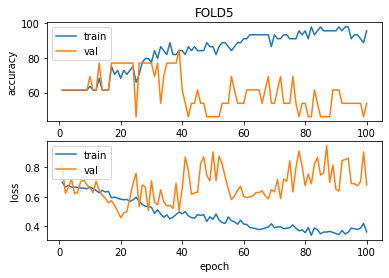

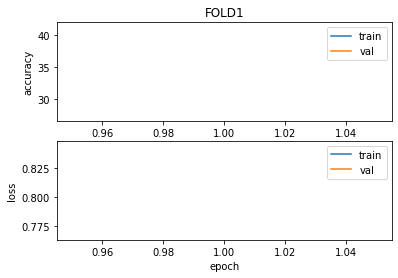

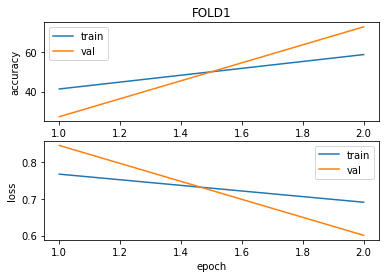

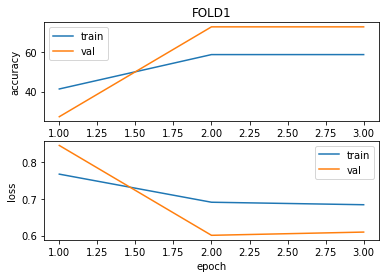

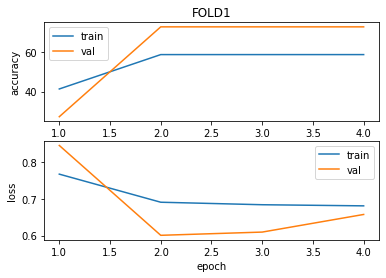

...

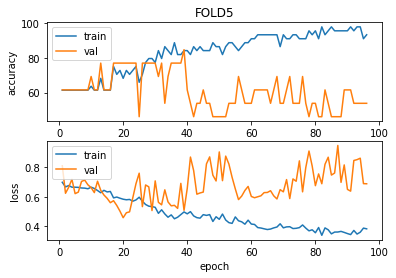

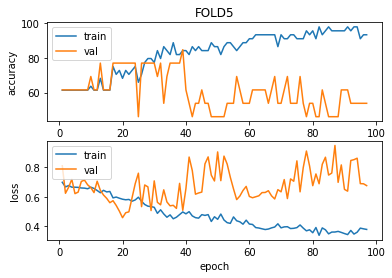

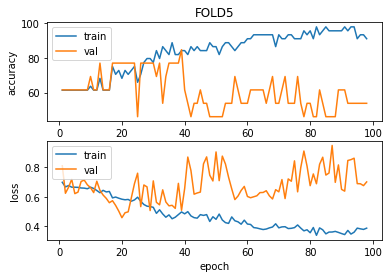

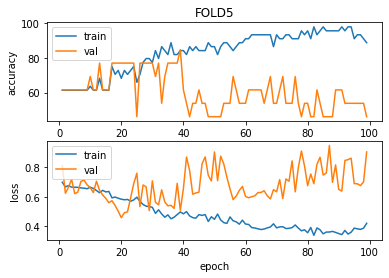

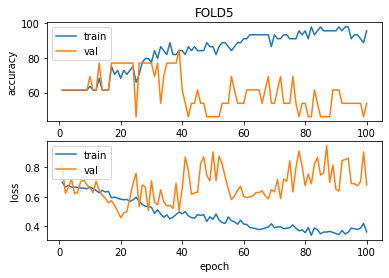

In [28]:
acc, main_net = cross_validation()

In [29]:
print("mean accuracy: ", np.mean(acc))

mean accuracy:  48.95104895104895


In [30]:
acc

[45.45454545454545,
 54.54545454545455,
 54.54545454545455,
 36.36363636363637,
 53.84615384615385]

In [31]:
torch.save(main_net,'/content/drive/My Drive/BMI1/data/main_net.pt' )

# Grad-CAM

In [32]:
!pip install medcam

     |████████████████████████████████| 81kB 7.4MB/s 
     |████████████████████████████████| 44.9MB 1.3MB/s 


In [92]:
from medcam import medcam
from PIL import Image

model = medcam.inject(main_net, output_dir='attention_maps', backend='gcam', layer='auto', label= 0, save_maps=True)

dataset = LungDataset (all_pixels, all_labels)  

dataloader = torch.utils.data.DataLoader(dataset=dataset,
                                                batch_size=batch_size,
                                                shuffle=True)  
for batch in dataloader:
    _ = model(batch[0].to(device))
    pils = 255 * np.array(batch[0][0][0][0])
    im = Image.fromarray(pils.astype(np.uint8), mode='L')
    im.save("image.png")


Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1
Selected module layer: block1


In [37]:
!pip install nibabel

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 5.0
  


(20, 224, 224)


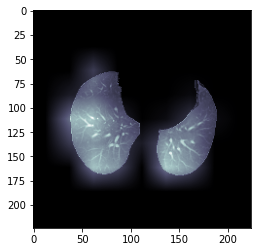

In [94]:
from IPython.display import Image
import nibabel as nib
import matplotlib.pyplot as plt
import cv2

img_arr = nib.load('/content/attention_maps/block1/attention_map_0_0_0.nii.gz').get_data()
img_arr = cv2.resize(img_arr , (224,224))
img_arr = img_arr.transpose(2,0,1)
img_arr = scipy.ndimage.interpolation.zoom(img_arr, [20/3, 1,1 ], mode='nearest')
print(img_arr.shape)
orig_im = cv2.imread("image.png", cv2.IMREAD_GRAYSCALE )

heatmap = img_arr[0]
heatmap = np.float32(heatmap) / 255
    
#add the heatmap to the original image
cam = heatmap + np.float32(cv2.resize(orig_im, (224,224))/255.)
cam = cam / np.max(cam)
# plt.imshow(heatmap, cmap= plt.cm.bone)
plt.imshow(cam, cmap= plt.cm.bone)
plt.pause(3)
